### Technical Indicators

* **Trend following & momentum indicators**: measure rate of change in price, identify direction and strength of the change (RSI - Relative strength index)

* **Volatility Indicators**: Show the dispersion of price (BB - Bollinger Bands)

* **Volume Indicators**: Account for buying and selling pressure in the market (MFI - Money Flow Index)

In [207]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import time
from datetime import datetime
import pandas_ta as ta
import ccxt

import sys
import os

parent_dir = os.path.abspath(os.path.join(os.getcwd(), os.pardir))

sys.path.insert(0, parent_dir)

from algo_tools import algo_tools as ats

# Trading Indicators w/ Crypto

In [214]:
binanceus = ccxt.coinbase()
reloadedMarkets = binanceus.load_markets(reload=True)

In [215]:
def load_crypto_data(exchange, since, symbol, timeframe):
    data = []
    print(symbol)
    while since < exchange.milliseconds():
        try:
            ohlcv = exchange.fetch_ohlcv(symbol, timeframe, since, params={})
            data += ohlcv
            since = max(ohlcv)[0] + 1
            print(pd.to_datetime(since, unit='ms'))
            # time.sleep(1)
        except Exception as e:
            print('Error:', e)
            break
    print('Done')
    
    data = pd.DataFrame(data, columns=['timestamp', 'open', 'high', 'low', 'close', 'volume'])

    data['date'] = pd.to_datetime(data['timestamp'], unit='ms')
    
    data.set_index('date', inplace=True)
    
    return data

In [220]:
since = binanceus.parse8601('2021-10-01T00:00:00Z')
symbols = ['BTC/USDT']
symbol='BTC/USDT'
timeframe = '1m'

In [221]:
ds_dict = {}

for symbol in symbols:
    data = load_crypto_data(exchange=binanceus, since=since, symbol=symbol, timeframe=timeframe)
    ds_dict[symbol] = data

BTC/USDT
2021-10-01 05:00:00.001000
2021-10-01 10:00:00.001000
2021-10-01 15:00:00.001000
2021-10-01 20:00:00.001000
2021-10-02 01:00:00.001000
2021-10-02 06:00:00.001000
2021-10-02 11:00:00.001000
2021-10-02 16:00:00.001000
2021-10-02 21:00:00.001000
2021-10-03 02:00:00.001000
2021-10-03 06:59:00.001000
2021-10-03 11:59:00.001000
2021-10-03 16:59:00.001000
2021-10-03 21:59:00.001000
2021-10-04 02:59:00.001000
2021-10-04 07:58:00.001000
2021-10-04 12:58:00.001000
2021-10-04 17:58:00.001000
2021-10-04 22:58:00.001000
2021-10-05 03:58:00.001000
2021-10-05 08:58:00.001000
2021-10-05 13:58:00.001000
2021-10-05 18:58:00.001000
2021-10-05 23:57:00.001000
2021-10-06 04:56:00.001000
2021-10-06 09:56:00.001000
2021-10-06 14:56:00.001000
2021-10-06 19:56:00.001000
2021-10-07 00:56:00.001000
2021-10-07 05:54:00.001000
2021-10-07 10:54:00.001000
2021-10-07 15:54:00.001000
2021-10-07 20:54:00.001000
2021-10-08 01:53:00.001000
2021-10-08 06:53:00.001000
2021-10-08 11:53:00.001000
2021-10-08 16:53:00

In [228]:
ds_dict['BTC/USDT']['timestamp'] = pd.to_datetime(ds_dict['BTC/USDT']['timestamp'], unit='ms').dt.tz_localize('UTC').dt.tz_convert('US/Central')

In [231]:
ds_dict['BTC/USDT']['timestamp'] = ds_dict['BTC/USDT']['timestamp'].dt.tz_convert('US/Central')

In [232]:
ds_dict['BTC/USDT'].tail()

,timestamp,open,high,low,close,volume
date,,,,,,
2024-11-08 01:57:00,2024-11-07 19:57:00-06:00,75978.83,75988.87,75942.20,75942.20,0.265514
2024-11-08 01:59:00,2024-11-07 19:59:00-06:00,75978.07,75986.33,75977.62,75986.33,0.043632
2024-11-08 02:01:00,2024-11-07 20:01:00-06:00,75909.12,76000.21,75878.72,76000.21,0.299948
2024-11-08 02:02:00,2024-11-07 20:02:00-06:00,75954.93,75954.93,75937.44,75937.44,0.122458
2024-11-08 02:03:00,2024-11-07 20:03:00-06:00,75940.61,75940.61,75926.06,75926.06,0.089126


### RSI Indicator
$$
RSI = 100 - 100/RS
$$
$$
RS = GAINS/LOSES
$$

In [271]:
rsi_period = 14
bb_period = 20 
bb_std = 2
mfi_period = 20

for i in list(ds_dict.keys()):
    ### Relative Strength Index
    ds_dict[i][f'rsi_{rsi_period}'] = ta.rsi(ds_dict[i].close, length=rsi_period)

    ds_dict[i]['rsi_signal'] = 0

    ds_dict[i]['rsi_sell_threshold'] = 70
    ds_dict[i]['rsi_buy_threshold'] = 30


    conditions = [
        (ds_dict[i][f'rsi_{rsi_period}'] >= ds_dict[i]['rsi_sell_threshold']),
        (ds_dict[i][f'rsi_{rsi_period}'] <= ds_dict[i]['rsi_buy_threshold'])
    ]
    
    results = [-1, 1]

    ds_dict[i]['rsi_signal'] = np.select(
        conditions, results, default=0
    )

    ### Bollinger Bands
    bb_dataset = ta.bbands(ds_dict[i]['close'], length = bb_period, std = bb_std)

    ds_dict[i] = pd.concat([ds_dict[i], bb_dataset[['BBL_20_2.0','BBU_20_2.0']]], axis=1)

    ds_dict[i]['bb_signal'] = 0

    conditions = [
        (ds_dict[i]['close'] >= ds_dict[i]['BBU_20_2.0']),
        (ds_dict[i]['close'] <= ds_dict[i]['BBL_20_2.0'])
    ]

    results = [-1, 1]

    ds_dict[i]['bb_signal'] = np.select(
        conditions, results, default=0
    )

    ### Money Flow Index
    ds_dict[i][f'mfi_{mfi_period}'] = ta.mfi(
        high = ds_dict[i]['high'], 
        low = ds_dict[i]['low'], 
        close = ds_dict[i]['close'], 
        volume = ds_dict[i]['volume'], 
        length = mfi_period
    )
    
    ds_dict[i]['mfi_signal'] = 0
    ds_dict[i]['mfi_sell_threshold'] = 80
    ds_dict[i]['mfi_buy_threshold'] = 20

    conditions = [
        (ds_dict[i][f'mfi_{mfi_period}'] >= ds_dict[i]['mfi_sell_threshold']),
        (ds_dict[i][f'mfi_{mfi_period}'] <= ds_dict[i]['mfi_buy_threshold'])
    ]

    results = [-1, 1]

    ds_dict[i]['mfi_signal'] = np.select(
        conditions, results, default=0
    )

    conditions = [
        (ds_dict[i]['rsi_signal'] == 1) & (ds_dict[i]['bb_signal'] == 1) & (ds_dict[i]['mfi_signal'] == 1),
        (ds_dict[i]['rsi_signal'] == -1) & (ds_dict[i]['bb_signal'] == -1) & (ds_dict[i]['mfi_signal'] == -1)
    ]

    results = [1, -1]

    ds_dict[i]['trade_signal'] = np.select(
        conditions, results, default=0
    )

C:\Users\harri\AppData\Local\Temp\ipykernel_17016\936846477.py:46: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ 433382.11859927  380152.27080796  396058.3506892  ... 8785381.65876847
 7576889.51327874 4301250.41396627]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.

C:\Users\harri\AppData\Local\Temp\ipykernel_17016\936846477.py:46: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ 514398.18974659  470244.73111454  901173.14411227 ... 2755522.7197013
 1391500.78539187 1416103.15218983]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.



In [272]:
ds_dict['BTC/USDT'].tail()

,timestamp,open,high,low,close,volume,rsi_14,rsi_signal,rsi_sell_threshold,rsi_buy_threshold,BBL_20_2.0,BBU_20_2.0,bb_signal,mfi_20,mfi_signal,mfi_sell_threshold,mfi_buy_threshold,trade_signal
date,,,,,,,,,,,,,,,,,,
2024-11-06 22:00:00,1730930400000,75904.06,76039.46,75539.57,75671.07,41.568404,70.164202,-1,70,30,72886.338359,76119.140641,0,74.411639,0,80,20,0
2024-11-06 23:00:00,1730934000000,75668.08,75848.40,75561.47,75570.91,36.419683,68.820735,0,70,30,72884.400313,76243.580687,0,68.789228,0,80,20,0
2024-11-07 00:00:00,1730937600000,75589.10,75648.26,75074.37,75346.55,18.465597,65.782257,0,70,30,72910.000084,76324.982916,0,66.248454,0,80,20,0
2024-11-07 01:00:00,1730941200000,75314.61,76031.66,75239.55,75405.18,56.925872,66.202194,0,70,30,72908.158157,76389.965843,0,65.962243,0,80,20,0
2024-11-07 02:00:00,1730944800000,75388.48,75458.51,75139.61,75158.50,18.818095,62.714793,0,70,30,72946.512764,76438.728236,0,61.518060,0,80,20,0


In [273]:
px.line(ds_dict['BTC/USDT'], x=ds_dict['BTC/USDT'].index, y=['rsi_14','rsi_sell_threshold','rsi_buy_threshold'], title='BTC/USDT RSI')

In [275]:
px.line(ds_dict['BTC/USDT'], x=ds_dict['BTC/USDT'].index, y=['close','BBU_20_2.0','BBL_20_2.0'], title='BTC/USDT BB')

In [274]:
df = ds_dict['BTC/USDT'].copy()
df['close'] = df['close']/1000
px.line(
    df, 
    x=df.index, 
    y=['close','mfi_20','mfi_sell_threshold','mfi_buy_threshold'], 
    title='BTC/USDT MFI')

In [276]:
for i in list(ds_dict.keys()):
    print(i)
    print(ds_dict[i].rsi_signal.value_counts())
    print(ds_dict[i].bb_signal.value_counts())
    print(ds_dict[i].mfi_signal.value_counts())
    print('\n')

BTC/USDT
rsi_signal
 0    24217
-1     1627
 1     1347
Name: count, dtype: int64
bb_signal
 0    23692
-1     1787
 1     1712
Name: count, dtype: int64
mfi_signal
 0    25274
-1     1039
 1      878
Name: count, dtype: int64




In [277]:
ds_dict['BTC/USDT'].tail()

,timestamp,open,high,low,close,volume,rsi_14,rsi_signal,rsi_sell_threshold,rsi_buy_threshold,BBL_20_2.0,BBU_20_2.0,bb_signal,mfi_20,mfi_signal,mfi_sell_threshold,mfi_buy_threshold,trade_signal
date,,,,,,,,,,,,,,,,,,
2024-11-06 22:00:00,1730930400000,75904.06,76039.46,75539.57,75671.07,41.568404,70.164202,-1,70,30,72886.338359,76119.140641,0,74.411639,0,80,20,0
2024-11-06 23:00:00,1730934000000,75668.08,75848.40,75561.47,75570.91,36.419683,68.820735,0,70,30,72884.400313,76243.580687,0,68.789228,0,80,20,0
2024-11-07 00:00:00,1730937600000,75589.10,75648.26,75074.37,75346.55,18.465597,65.782257,0,70,30,72910.000084,76324.982916,0,66.248454,0,80,20,0
2024-11-07 01:00:00,1730941200000,75314.61,76031.66,75239.55,75405.18,56.925872,66.202194,0,70,30,72908.158157,76389.965843,0,65.962243,0,80,20,0
2024-11-07 02:00:00,1730944800000,75388.48,75458.51,75139.61,75158.50,18.818095,62.714793,0,70,30,72946.512764,76438.728236,0,61.518060,0,80,20,0


In [236]:
products = ['BTC/USDT', 'ETH/USDT']

for prod in products:
        
    df = ds_dict[prod].copy()

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=df.index, y=df['close'], mode='lines', name='close'))

    for date, signal in zip(df.index, df['trade_signal']):
        if signal == 1:
            fig.add_shape(
                type='line',
                x0=date,x1=date,
                y0=df['close'].min(), y1=df['close'].max(),
                line=dict(color='green', width=1),
                name='Buy'
            )
        elif signal == -1:
            fig.add_shape(
                type='line',
                x0=date,x1=date,
                y0=df['close'].min(), y1=df['close'].max(),
                line=dict(color='red', width=1),
                name='Sell'
            )

    fig.update_layout(
        title = f"{prod} Close Price and Strategy Signals",
        xaxis_title = "Date",
        yaxis_title = "Close Price",
        xaxis_rangeslider_visible=False
    )

    fig.show()

### Backtesting

In [294]:
btc_df = ds_dict['BTC/USDT'].copy()
btc_df['returns'] = np.log(btc_df['close'] / btc_df['close'].shift(1))
btc_df['strategy_returns'] = btc_df['trade_signal'].shift(1) * btc_df['returns']
btc_df['strategy_returns'] = btc_df['strategy_returns'].fillna(0)
btc_df['cumulative_strategy_returns'] = btc_df['strategy_returns'].cumsum().apply(np.exp)
btc_df['accum_buy_hold'] = btc_df['returns'].cumsum().apply(np.exp)

In [315]:
trading_cost = 0.1/100
btc_df['trades'] = btc_df['trade_signal'].diff().fillna(0)
btc_df.loc[btc_df.index[0],"trades"] = np.abs(btc_df.loc[df.index[0],"trade_signal"]-0)
btc_df.loc[btc_df.index[-1],"trades"] = np.abs(0-btc_df.loc[df.index[-1],"trade_signal"])

btc_df["strategy_returns_tc"] = btc_df["strategy_returns"] - btc_df["trades"] * trading_cost
btc_df['cumulative_strategy_returns_tc'] = btc_df['strategy_returns_tc'].cumsum().apply(np.exp)

In [317]:
btc_df.tail()

,timestamp,open,high,low,close,volume,rsi_14,rsi_signal,rsi_sell_threshold,rsi_buy_threshold,...,mfi_sell_threshold,mfi_buy_threshold,trade_signal,returns,strategy_returns,cumulative_strategy_returns,accum_buy_hold,trades,strategy_returns_tc,cumulative_strategy_returns_tc
date,,,,,,,,,,,,,,,,,,,,,
2024-11-06 22:00:00,1730930400000,75904.06,76039.46,75539.57,75671.07,41.568404,70.164202,-1,70,30,...,80,20,0,-0.003103,-0.0,1.006947,1.732835,0.0,-0.0,1.006947
2024-11-06 23:00:00,1730934000000,75668.08,75848.40,75561.47,75570.91,36.419683,68.820735,0,70,30,...,80,20,0,-0.001325,-0.0,1.006947,1.730541,0.0,-0.0,1.006947
2024-11-07 00:00:00,1730937600000,75589.10,75648.26,75074.37,75346.55,18.465597,65.782257,0,70,30,...,80,20,0,-0.002973,-0.0,1.006947,1.725403,0.0,-0.0,1.006947
2024-11-07 01:00:00,1730941200000,75314.61,76031.66,75239.55,75405.18,56.925872,66.202194,0,70,30,...,80,20,0,0.000778,0.0,1.006947,1.726746,0.0,0.0,1.006947
2024-11-07 02:00:00,1730944800000,75388.48,75458.51,75139.61,75158.50,18.818095,62.714793,0,70,30,...,80,20,0,-0.003277,-0.0,1.006947,1.721097,0.0,-0.0,1.006947


In [316]:
df = btc_df.copy()
px.line(
    df, 
    x=df.index, 
    y=['cumulative_strategy_returns','cumulative_strategy_returns_tc','accum_buy_hold'], 
    title='Cumuative Strategy Returns')

# Pair Trading Strategy w/ Crypto

In [129]:
all_df = ats().get_yfinance_returns(['ARKB','IBIT','BTC-USD','ETH-USD','COIN','GBTC','QQQ','SOL-USD'], start_date='2000-01-01', end_date='2024-09-30')
all_df = all_df.stack(level=0).reset_index()
all_df = all_df.loc[all_df['Price']=='Adj Close'].drop('Price', axis=1)
all_df.set_index('Date', inplace=True)

[*********************100%***********************]  8 of 8 completed


In [130]:
all_df['GBTC'].dropna()

Date
2015-05-11 00:00:00+00:00     0.549451
2015-05-12 00:00:00+00:00     0.548901
2015-05-13 00:00:00+00:00     0.538462
2015-05-14 00:00:00+00:00     0.494505
2015-05-15 00:00:00+00:00     0.417582
                               ...    
2024-09-23 00:00:00+00:00    50.410000
2024-09-24 00:00:00+00:00    51.230000
2024-09-25 00:00:00+00:00    50.299999
2024-09-26 00:00:00+00:00    51.540001
2024-09-27 00:00:00+00:00    52.310001
Name: GBTC, Length: 2363, dtype: float64

In [131]:
corr_matrix = all_df.corr()
corr_matrix

Ticker,ARKB,BTC-USD,COIN,ETH-USD,GBTC,IBIT,QQQ,SOL-USD
Ticker,,,,,,,,
ARKB,1.000000,0.996554,0.897637,0.780642,0.952112,0.999982,0.376251,0.889014
BTC-USD,0.996554,1.000000,0.837715,0.927224,0.970141,0.996480,0.927471,0.810685
COIN,0.897637,0.837715,1.000000,0.890875,0.833188,0.897980,0.573710,0.758078
ETH-USD,0.780642,0.927224,0.890875,1.000000,0.835132,0.781200,0.855139,0.874827
GBTC,0.952112,0.970141,0.833188,0.835132,1.000000,0.952210,0.868649,0.744723
IBIT,0.999982,0.996480,0.897980,0.781200,0.952210,1.000000,0.376313,0.889412
QQQ,0.376251,0.927471,0.573710,0.855139,0.868649,0.376313,1.000000,0.763368
SOL-USD,0.889014,0.810685,0.758078,0.874827,0.744723,0.889412,0.763368,1.000000


<Axes: xlabel='Ticker', ylabel='Ticker'>

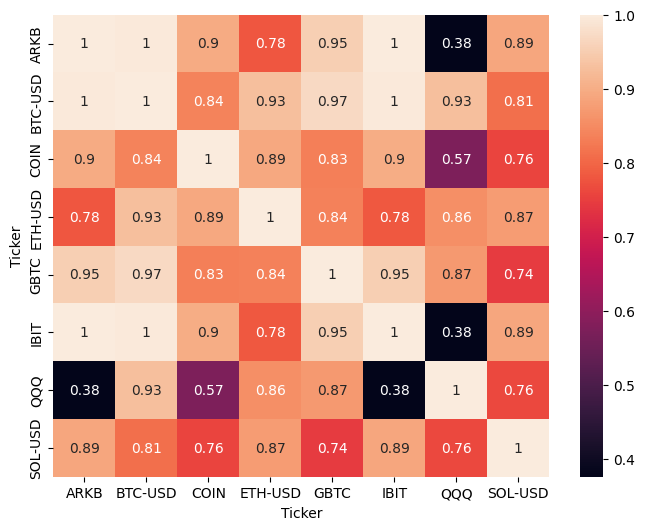

In [132]:
import seaborn as sn
from matplotlib.pyplot import figure

figure(figsize=(8,6))
sn.heatmap(corr_matrix, annot=True)

In [134]:
plot_df = all_df.copy()
px.line(
    plot_df, 
    x=plot_df.index,
    y=plot_df.columns,
)

##### Cointegration value - Null hyp = no cointegration

In [135]:
import statsmodels.tsa.stattools as ts
from statsmodels.tsa.stattools import adfuller

In [176]:
pair_df = all_df[['BTC-USD','SOL-USD']].ffill().rolling(window=5, min_periods=1).mean().dropna()
pair_df = pair_df.loc[pair_df.index>='2021-09-01']

In [177]:
pair_df.head()

Ticker,BTC-USD,SOL-USD
Date,,
2021-09-01 00:00:00+00:00,48160.186719,104.246886
2021-09-02 00:00:00+00:00,48245.250781,110.526729
2021-09-03 00:00:00+00:00,48484.359375,120.949405
2021-09-04 00:00:00+00:00,49062.287500,126.663057
2021-09-05 00:00:00+00:00,49979.632031,133.380478


In [178]:
pair_df.corr()

Ticker,BTC-USD,SOL-USD
Ticker,,
BTC-USD,1.000000,0.913642
SOL-USD,0.913642,1.000000


In [179]:
asset1 = 'BTC-USD'
asset2 = 'SOL-USD'

result = ts.coint(pair_df[asset1], pair_df[asset2])

print(f"p-value for augmented Engle-Granger test: {result[1]}")

print(f"Asset p-value for Augmented Dickey-Fuller test: {adfuller(pair_df[asset2])[1]}")
print(f"Spread p-value for Augmented Dickey-Fuller test: {adfuller(pair_df[asset1] - pair_df[asset2])[1]}")
print(f"Price ratio p-value for Augmented Dickey-Fuller test: {adfuller(pair_df[asset1]/pair_df[asset2])[1]}")

p-value for augmented Engle-Granger test: 0.4171774325620317
Asset p-value for Augmented Dickey-Fuller test: 0.5541679647508221
Spread p-value for Augmented Dickey-Fuller test: 0.8106891686612802
Price ratio p-value for Augmented Dickey-Fuller test: 0.5312289511815439


In [200]:
import statsmodels.api as sm

s1 = sm.add_constant(pair_df[asset1])
s2 = pair_df[asset2]
results = sm.OLS(s2, s1).fit()
s1 = s1[asset1]
b = results.params[asset1]
spread = s2 - b * s1

pair_df['spread'] = spread
pair_df['price_ratio'] = pair_df[asset1] / pair_df[asset2]
pair_df = pair_df.loc[pair_df.index>='2024-01-01']

pair_df['spread_mean'] = pair_df['spread'].mean()
pair_df['price_ratio_mean'] = pair_df['price_ratio'].mean()
pair_df['spread_ema20'] = pair_df['spread'].ewm(span=20).mean()


plot_df = pair_df.copy()
px.line(
    plot_df, 
    x=plot_df.index,
    y=['spread','spread_mean'],
)

In [201]:
plot_df = pair_df.copy()
px.line(
    plot_df, 
    x=plot_df.index,
    y=['price_ratio','price_ratio_mean'],
)

# Pair trading mean reversion
* Long the spread
  * When the spread is small and expect it to revert. Go long S2 and short S1.
* Short the spread
  * When the spread is large and expect it to revert. Go short S2 and long S1.

* Go long spread when z-score is below -1.0
* Go short spread when z-score is above 1.0

In [202]:
pair_df['z_score'] = (pair_df['spread'] - pair_df['spread'].mean()) / pair_df['spread'].std()

plot_df = pair_df.copy()

px.line(
    plot_df, 
    x=plot_df.index,
    y=[
        'z_score',
        [1]*len(plot_df),
        [-1]*len(plot_df)
    ],
)

##### Spread vs 20 EMA Spread

In [204]:
px.line(
    pair_df, 
    x=pair_df.index,
    y=['spread','spread_ema20'],
)

##### Rolling statistics

In [211]:
window_size = 30
rolling_betas = []
rolling_spread = []
rolling_mean_spread = [] 

for i in range(len(s1)-window_size+1):
    s1_window = s1.iloc[i:i+window_size]
    s2_window = s2.iloc[i:i+window_size]
    s1_window = sm.add_constant(s1_window)
    model = sm.OLS(s2_window, s1_window).fit()
    rolling_betas.append(model.params[1])

rolling_betas = pd.Series(rolling_betas, index=s1.index[window_size-1:])

C:\Users\harri\AppData\Local\Temp\ipykernel_38252\847885349.py:9: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\harri\AppData\Local\Temp\ipykernel_38252\847885349.py:9: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\harri\AppData\Local\Temp\ipykernel_38252\847885349.py:9: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\harri\AppData\Local\Temp\ipykernel_38252\847885349.py:9: FutureWarning:

Series.__getitem__

In [213]:
pair_df['rolling_spread'] = s2 - rolling_betas * s1